In [1]:
import os
import glob
import pandas
import seaborn as sns
import matplotlib.pyplot as plt, mpld3
%matplotlib inline

In [2]:
path_datasets_dir = r'./datasets'
path_datasets_files = glob.glob(path_datasets_dir + "/*.csv")

In [3]:
dfs = []

for path_datasets_file in path_datasets_files:
    df_temp = pandas.read_csv(path_datasets_file)
    dfs.append(df_temp)

df = pandas.concat(dfs, axis=0, ignore_index=True, keys=['current_date', 'category_id'], sort=True)
df

,Unnamed: 0,category_id,category_name,current_date,price_bulk,price_iva,price_unit,product_id,product_name,subcategory_id,subcategory_name
0,0,12,"Aceite, especias y salsas",2022-06-05,0.19,10,0.19,19733.0,Sal gruesa Hacendado,112,"Aceite, vinagre y sal"
1,1,12,"Aceite, especias y salsas",2022-06-05,1.52,10,0.38,19715.0,Sal de mesa Hacendado,112,"Aceite, vinagre y sal"
2,2,12,"Aceite, especias y salsas",2022-06-05,0.18,10,0.18,19732.0,Sal yodada fina Hacendado,112,"Aceite, vinagre y sal"
3,3,12,"Aceite, especias y salsas",2022-06-05,0.21,10,0.21,19731.0,Sal de mesa fina Hacendado,112,"Aceite, vinagre y sal"
4,4,12,"Aceite, especias y salsas",2022-06-05,0.36,10,0.71,19734.0,Sal gruesa para hornear Hacendado,112,"Aceite, vinagre y sal"
...,...,...,...,...,...,...,...,...,...,...,...
13937,6966,10,Zumos,2022-06-08,0.65,10,0.65,39394.0,Zumo de tomate Hacendado,98,Tomate y otros sabores
13938,6967,10,Zumos,2022-06-08,1.44,10,1.15,39395.0,Zumo de tomate Hacendado,98,Tomate y otros sabores
13939,6968,10,Zumos,2022-06-08,3.32,10,1.99,39301.0,Zumo de tomate Sanflavino,98,Tomate y otros sabores
13940,6969,10,Zumos,2022-06-08,1.36,10,1.36,39922.0,Zumo de manzana selección Hacendado,98,Tomate y otros sabores


/tmp/ipykernel_15003/1483899775.py:24: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()
/tmp/ipykernel_15003/1483899775.py:24: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()
/tmp/ipykernel_15003/1483899775.py:24: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()
/tmp/ipykernel_15003/1483899775.py:24: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()
/tmp/ipykernel_15003/1483899775.py:24: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()
/tmp/ipykernel_15003/1483899775.py:24: UserWa

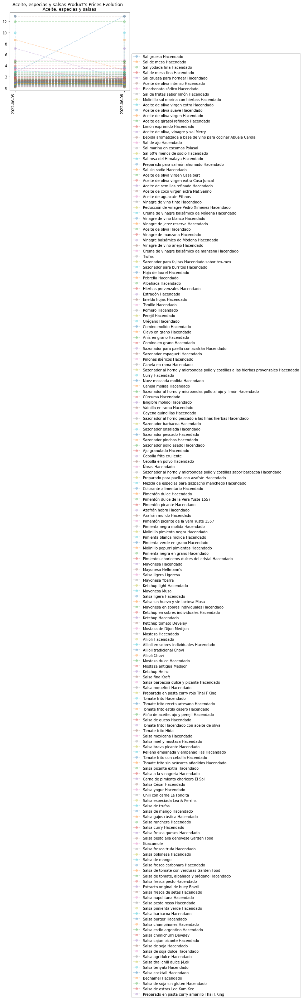

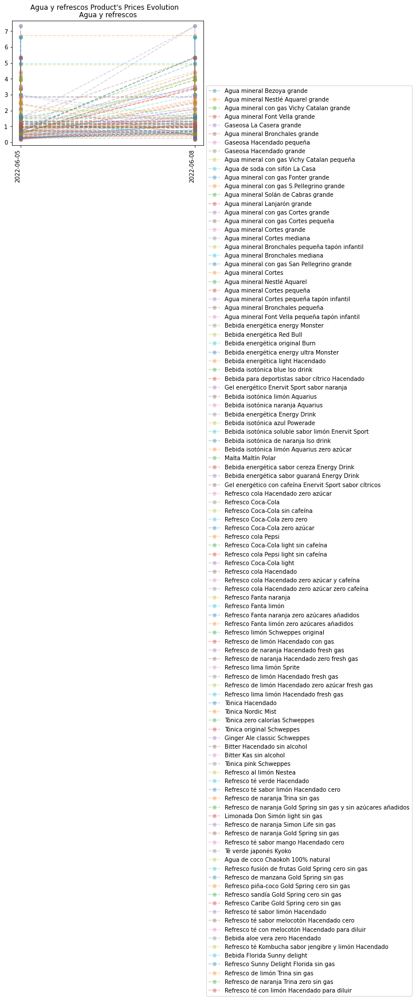

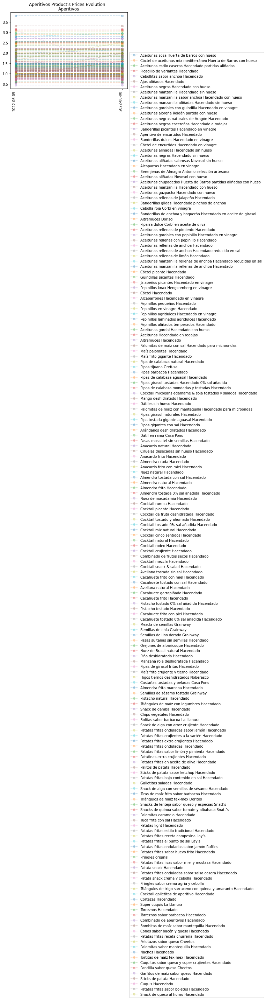

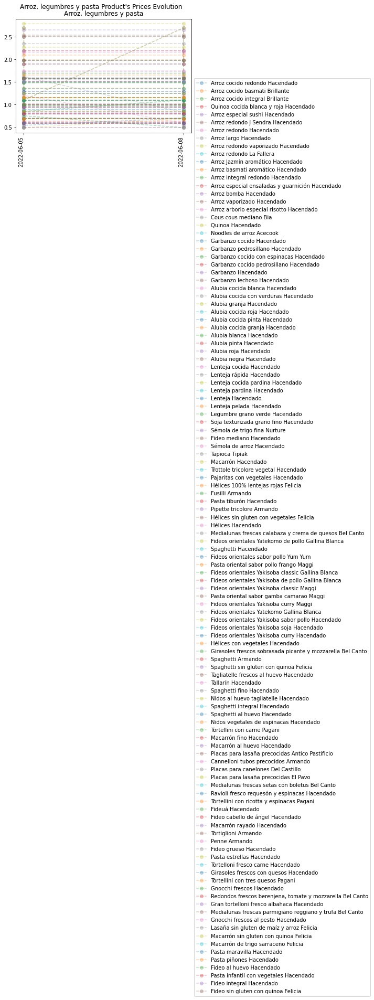

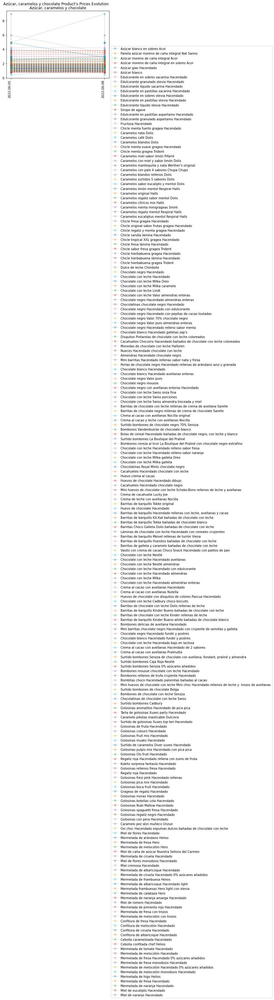

...

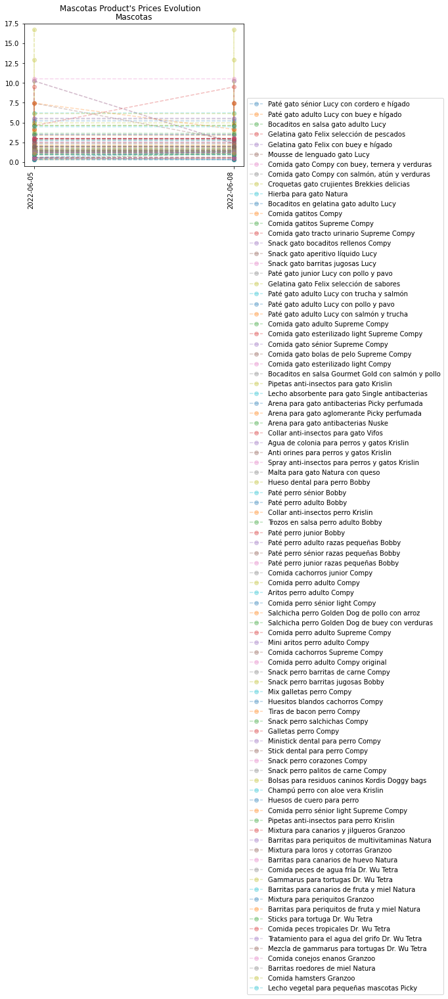

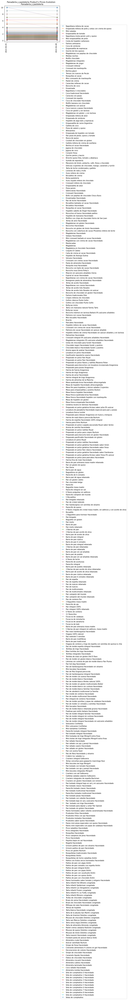

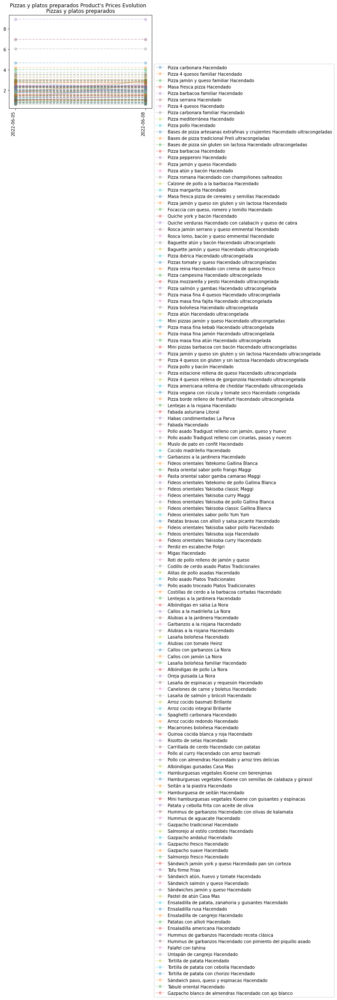

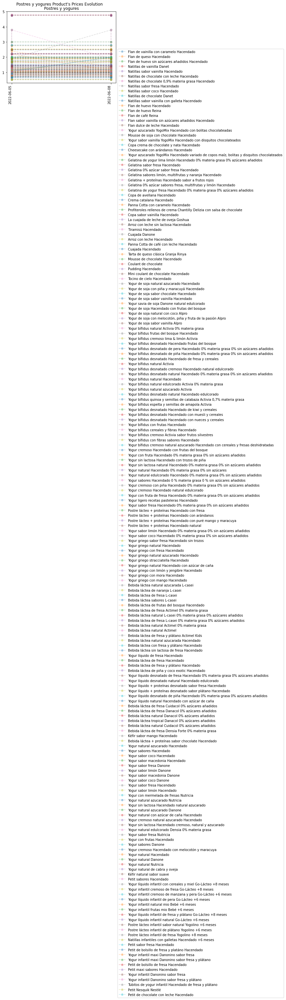

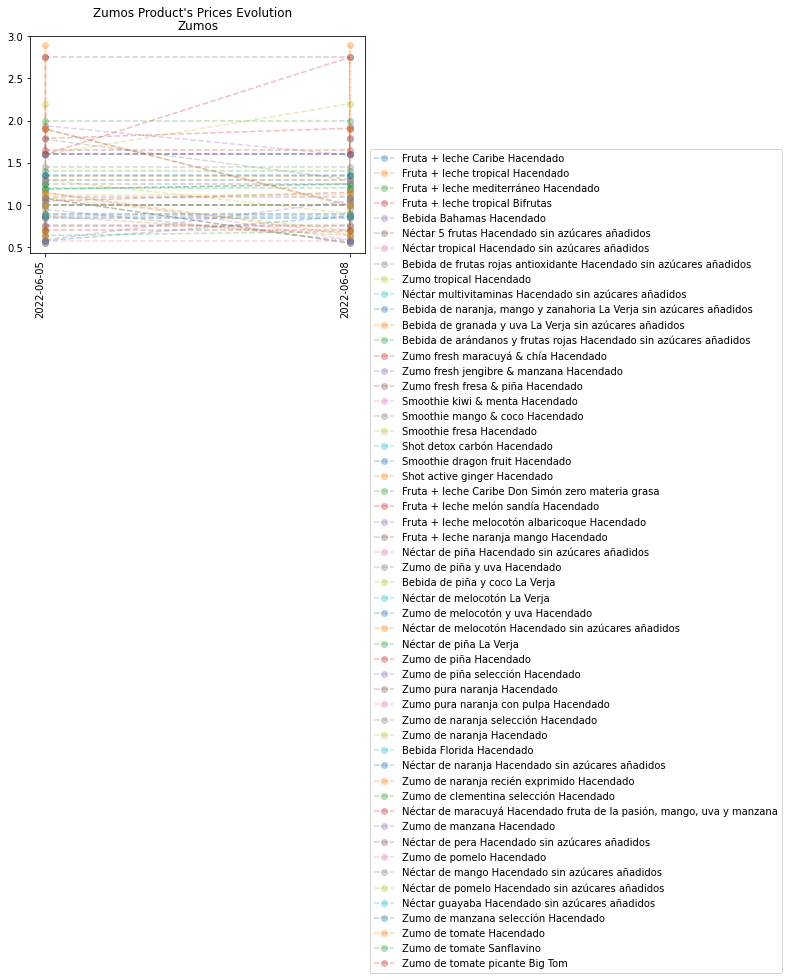

In [4]:
categories_names = df.category_name.unique()

for count, category_name in enumerate(categories_names):

    df_category = df[df.category_name == category_name]
    
    products_names = df_category.product_name.unique()

    fig, axs = plt.subplots(1)
    fig.suptitle(f'{category_name} Product\'s Prices Evolution')
    output = ""
    path_datasets_graph = f'graphs/{category_name}.svg'

    for product_name in products_names:
        df_temp = df_category[df_category.product_name == product_name]
        x = df_temp.current_date
        y = df_temp.price_unit

        axs.plot( x, y, 'o--', alpha=0.3, label=product_name )

    plt.grid(axis='x', color='1.0')
    plt.title(category_name.capitalize())
    plt.legend(bbox_to_anchor=(1.0, 0.5))
    plt.xticks(rotation=90, ha='right')
    # plt.savefig(path_datasets_graph)
    plt.plot()